In [1]:
import numpy as np
import xarray as xr
import sys
import glob
import netCDF4 as nc
import os
import sys
import h5py
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from os.path import join,expanduser,exists,split
user_home_dir = expanduser('~')
sys.path.append(join(user_home_dir,'ECCOv4-py'))
import ecco_v4_py as ecco

# Suppress warning messages for a cleaner presentation
import warnings
warnings.filterwarnings('ignore')

### Inputs

In [26]:
year_start = 2004  # Define the start year
year_end = 2016  # Define the end year (NOT included, will stop the year before this one)
# lev_or_int = 'zlev00' 
# lev_or_int = 'zlev09' 
# lev_or_int = 'zlev05' 
lev_or_int = 'k0_k5'

load_dir = '/Users/jacoposala/Downloads/figures_Oct24_k0/daily/'
load_dir = '/Users/jacoposala/Downloads/figures_Nov3_k9/daily/'
load_dir = '/Users/jacoposala/Downloads/figures_Nov5_k5/daily/'
load_dir = '/Users/jacoposala/Downloads/figures_Oct28_k0_k5/daily/'

ECCO_dir = '/Users/jacoposala/Desktop/CU/3.RESEARCH/NASA_project/NEW_heatBudgetECCO/data/'
save_dir = join(ECCO_dir,'outputs')
path = '/Users/jacoposala/Desktop/CU/3.RESEARCH/NASA_project/NEW_heatBudgetECCO/data/outputs/nc_files_zlev_or_zint/'
save_path = '/Users/jacoposala/Desktop/CU/3.RESEARCH/NASA_project/NEW_heatBudgetECCO/code/summary_maps/' + lev_or_int + '/'


### Load data

In [27]:
# Grid data
XC_lon = xr.open_dataset(path + 'ECCOv4r4_XC_lon_1993_2017.nc')
YC_lat = xr.open_dataset(path + 'ECCOv4r4_YC_lat_1993_2017.nc')
Z_depth = xr.open_dataset(path + 'ECCOv4r4_Z_depth_1993_2017.nc')

# Load the MATLAB v7.3 .mat file
file_path = load_dir + f'ECCOv4r4_heat_{lev_or_int}_daily_{year_start}_{year_end}_prcnt90_noTrend_minLen_5tsteps_withAVE.mat'

mat_data = h5py.File(file_path, 'r')

# List the keys in the file
# print("Keys in the file:", list(mat_data.keys()))

# Access the data under the key '#refs#'
refs_data = mat_data['#refs#']

# Access the data under the key 'find_MHWs_info'
find_mhws_info_data = mat_data['find_MHWs_info']

# List the keys in the file find_MHWs_info'
# print(find_mhws_info_data.keys())

# Calculate the duration of the decline pahse (as a difference between the total duration and the duration of the onset phase)
decline_duration_in_tsteps = find_mhws_info_data['events_duration_in_tsteps'].value - find_mhws_info_data['onset_duration_in_tsteps'].value


### Define functions

In [28]:
def shift_longitude(lon):
    return (lon + 180) % 360 - 180

def remove_text_after_second_underscore(name):
    parts = name.split('_')
    if len(parts) >= 3:
        return '_'.join(parts[:2])
    return name

In [29]:
# Main function to make maps
def plot_map_from_scattered(XC_lon, YC_lat, d2plot, keyplot, year_start, year_end, save_path, stat_tag):

    #__________
    # Set data needed for the map
    #__________
    # Reshape XC_lon and YC_lat to match data2plot shape
    d2plot_lon = np.reshape(XC_lon.XC_lon.values, [XC_lon.XC_lon.shape[0], XC_lon.XC_lon.shape[1]*XC_lon.XC_lon.shape[2]])
    d2plot_lat = np.reshape(YC_lat.YC_lat.values, [YC_lat.YC_lat.shape[0], YC_lat.YC_lat.shape[1]*YC_lat.YC_lat.shape[2]])

    # Define the new grid for the map (360x180)
    grid_x, grid_y = np.meshgrid(np.linspace(-179.5, 179.5, 360),
                                 np.linspace(-89.5, 89.5, 180), indexing='ij')

    # Shift longitudes
    d2plot_lon_shifted = shift_longitude(d2plot_lon)
   
    # Reshape XC_lon and YC_lat
    points = np.concatenate((np.reshape(d2plot_lon, [d2plot_lon.shape[0]*d2plot_lon.shape[1], 1]), np.reshape(d2plot_lat, [d2plot_lat.shape[0]*d2plot_lat.shape[1], 1])), axis=1)
    # Reshape data2plot
    values = np.reshape(d2plot, [d2plot.shape[0]*d2plot.shape[1], 1])

    # Interpolate using nearest neighbor
    grid_z0 = np.transpose(griddata(points, values, (grid_x, grid_y), method='nearest'), [1,0,2])[:,:,0]

    #__________
    # Set color bar details based on specific type of plot and/or variable being plotted
    #__________    
    # Determine vmax as the maximum absolute value
    if stat_tag in ['3rd_contributor', '1st_contributor', '2nd_contributor', 'positive_negative']: # for the plots for main contributor (and %)
        vmin = 0
        vmax = 100
        cmap = plt.get_cmap('hot_r')  # You can choose any other colormap
        levels = np.linspace(vmin, vmax, vmax-vmin+1)
        levels_cbar = levels[::5]
    elif keyplot in ['G_advection_eventAve', 'G_advection_onsetAve', 'G_advection_declineAve',\
                    'G_total_eventAve', 'G_total_onsetAve', 'G_total_declineAve']:
        vmax = 4.5E-6 ########### Change to -7 after testing
        vmin = -vmax
        cmap = plt.get_cmap('bwr')  # You can choose any other colormap
        levels = np.linspace(vmin, vmax, 20)
        levels_cbar = levels
    elif keyplot in ['G_diffusion_eventAve', 'G_diffusion_onsetAve', 'G_diffusion_declineAve', \
                     'G_forcing_eventAve', 'G_forcing_onsetAve', 'G_forcing_declineAve', \
                     'adv_vConv_eventAve', 'adv_vConv_onsetAve', 'adv_vConv_declineAve', \
                     'dif_vConv_eventAve', 'dif_vConv_onsetAve', 'dif_vConv_declineAve']:
        vmax = 4.5E-6
        vmin = -vmax
        cmap = plt.get_cmap('bwr')  # You can choose any other colormap
        levels = np.linspace(vmin, vmax, 20)
        levels_cbar = levels
    elif keyplot in ['data_used4MHWs_eventAve', 'data_used4MHWs_onsetAve', 'data_used4MHWs_declineAve']:
        vmax = 6
        vmin = -vmax
        cmap = plt.get_cmap('bwr')  # You can choose any other colormap
        levels = np.linspace(vmin, vmax, 20)
        levels_cbar = levels
    elif keyplot in ['events_duration_in_tsteps','onset_duration_in_tsteps', 'decline_duration_in_tsteps',
                     'events_number']:
        vmin = 0
        vmax = 60
        cmap = plt.get_cmap('hot_r')  # You can choose any other colormap
        levels = np.linspace(vmin, vmax, vmax-vmin+1)
        levels_cbar = levels[::2]

    # CREATE A FUNCTION FOR THIS BELOW    
    # Set other tags needed for the title of the map
    if 'onset' in keyplot:
        titletag = 'onset'
        value_tag = 'positive'
    elif 'decline' in keyplot:
        titletag = 'decline'
        value_tag = 'negative'
    else:
        titletag = 'events'
        
    common_name = remove_text_after_second_underscore(keyplot)
    
    #__________
    # Make plot
    #__________  
    fig = plt.figure(figsize=(20, 8))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.Robinson(central_longitude=-180))
    norm = mcolors.BoundaryNorm(levels, cmap.N)
    im = ax.pcolormesh(grid_x.T, grid_y.T, grid_z0, cmap=cmap, norm=norm, transform=ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgrey', zorder=1)
    fig.colorbar(im, ax=ax, ticks=levels_cbar, boundaries=levels)

    # Title varies based on type of plot 
    if 'events_number' in keyplot:
        plt.title(f'Number of MHW events (90%, Δt = 5 tsteps) during {year_start}-{year_end}')
    else:
        if stat_tag == 'positive_negative':
            plt.title(f'Percentage of time {common_name} is {value_tag} over MHWs {titletag} (90%, Δt = 5 tsteps) during {year_start}-{year_end}')
        elif stat_tag in ['3rd_contributor', '1st_contributor', '2nd_contributor']:
            plt.title(f'Percentage of time {common_name} is {value_tag} and {stat_tag} over MHWs {titletag} (90%, Δt = 5 tsteps) during {year_start}-{year_end}')        
        else:
            plt.title(f'{stat_tag} {common_name} over MHWs {titletag} (90%, Δt = 5 tsteps) during {year_start}-{year_end}')        

    # Save and show plot
    save_name = f'ECCOv4r4_heat_{lev_or_int}_daily_{year_start}_{year_end}_prcnt90_noTrend_minLen5tsteps_{keyplot}_{stat_tag}.png' 
    plt.savefig(save_path + save_name, dpi=300, facecolor='white', edgecolor='none', bbox_inches='tight')  # Save the figure
    plt.show()
    return

In [30]:
# # Define function to calculate data2plot
# def calculate_data2plot(find_mhws_info_data, key, operation):
#     data_values = find_mhws_info_data[key].value
#     if operation == 'mean':
#         return np.nanmean(data_values, axis=0)
#     elif operation == 'median':
#         return np.nanmedian(data_values, axis=0)
#     elif operation == 'max':
#         return np.nanmax(data_values, axis=0)
#     elif operation == 'min':
#         return np.nanmin(data_values, axis=0)

In [31]:
# Define function to calculate data2plot
def calculate_data2plot(data_values, operation):
    if operation == 'mean':
        return np.nanmean(data_values, axis=0)
    elif operation == 'median':
        return np.nanmedian(data_values, axis=0)
    elif operation == 'max':
        return np.nanmax(data_values, axis=0)
    elif operation == 'min':
        return np.nanmin(data_values, axis=0)

In [32]:
# Percentage of times a given term is positive (onset) or negative (decline)
def map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, phase, variable, save_path):
    phase_mapping = {
        'onset': 'onsetAve',
        'decline': 'declineAve'
    }

    phase_key = phase_mapping.get(phase, '')

    # Find when data are positive (onset) or negative (decline)
    data_values = find_mhws_info_data[f'G_{variable}_{phase_key}'].value
    if phase == 'onset':
        mask_values = data_values > 0
    elif phase == 'decline':
        mask_values = data_values < 0
    else:
        raise ValueError("Invalid phase provided")
    
    # Calculate percentage
    data2plot = np.sum(mask_values, axis=0) / np.sum(~np.isnan(data_values), axis=0) * 100
    plot_map_from_scattered(XC_lon=XC_lon, YC_lat=YC_lat, 
                            keyplot=f'G_{variable}_{phase_key}', d2plot=data2plot, 
                            year_start=year_start, year_end=year_end,
                            save_path=save_path, stat_tag='positive_negative')

In [33]:
# # Define function for creating and combining masks
# def map_contributor_dominant(find_mhws_info_data, key1, key2, key3, operator):
#     mask1 = operator(find_mhws_info_data[key1].value, 0)
#     mask2 = operator(find_mhws_info_data[key1].value, find_mhws_info_data[key2].value)
#     mask3 = operator(find_mhws_info_data[key1].value, find_mhws_info_data[key3].value)
#     mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))
#     data2plot = np.sum(mask_all, axis=0) / find_mhws_info_data['events_number'] * 100
#     plot_map_from_scattered(XC_lon=XC_lon, YC_lat=YC_lat, keyplot=key1, d2plot=data2plot, 
#                             year_start = year_start, year_end = year_end,
#                             save_path=save_path, stat_tag='dominant')

In [34]:
# Define function for creating and combining masks
def map_first_or_third_contributor(find_mhws_info_data, key1, key2, key3, operator, title_tag):
    mask1 = operator(find_mhws_info_data[key1].value, 0)
    mask2 = operator(find_mhws_info_data[key1].value, find_mhws_info_data[key2].value)
    mask3 = operator(find_mhws_info_data[key1].value, find_mhws_info_data[key3].value)
    mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))
    data2plot = np.sum(mask_all, axis=0) / find_mhws_info_data['events_number'] * 100
    plot_map_from_scattered(XC_lon=XC_lon, YC_lat=YC_lat, keyplot=key1, d2plot=data2plot, 
                            year_start = year_start, year_end = year_end,
                            save_path=save_path, stat_tag=title_tag)
    

In [35]:
# Define function for creating and combining masks
def map_second_contributor(find_mhws_info_data, key1, key2, key3, operator, title_tag):
    mask1 = np.logical_and(operator(find_mhws_info_data[key1].value, 0),
                            np.logical_or(np.logical_and(operator(find_mhws_info_data[key1].value, find_mhws_info_data[key3].value),
                                                        np.logical_not(operator(find_mhws_info_data[key1].value, find_mhws_info_data[key2].value))),
                                          np.logical_and(operator(find_mhws_info_data[key1].value, find_mhws_info_data[key2].value),
                                                        np.logical_not(operator(find_mhws_info_data[key1].value, find_mhws_info_data[key3].value)))))
    data2plot = np.sum(mask1, axis=0) / find_mhws_info_data['events_number'] * 100
    plot_map_from_scattered(XC_lon=XC_lon, YC_lat=YC_lat, keyplot=key1, d2plot=data2plot, 
                            year_start=year_start, year_end=year_end,
                            save_path=save_path, stat_tag=title_tag)

### Make plots

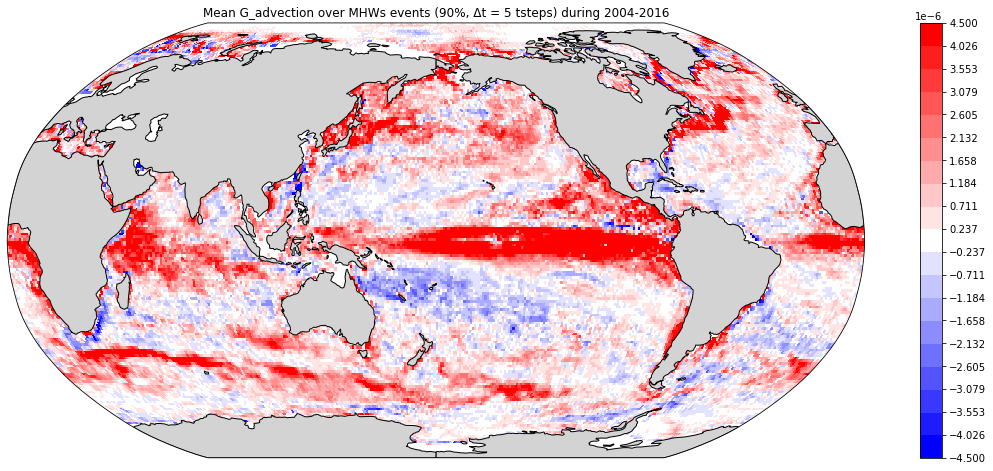

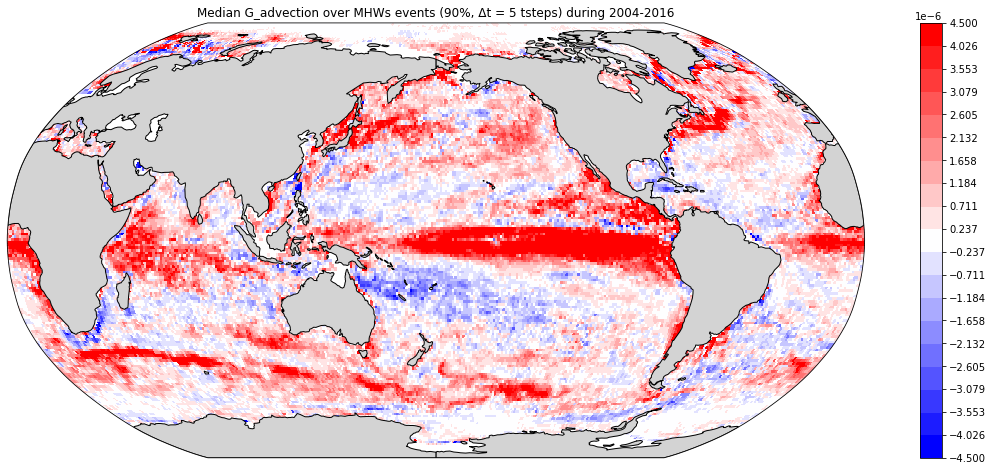

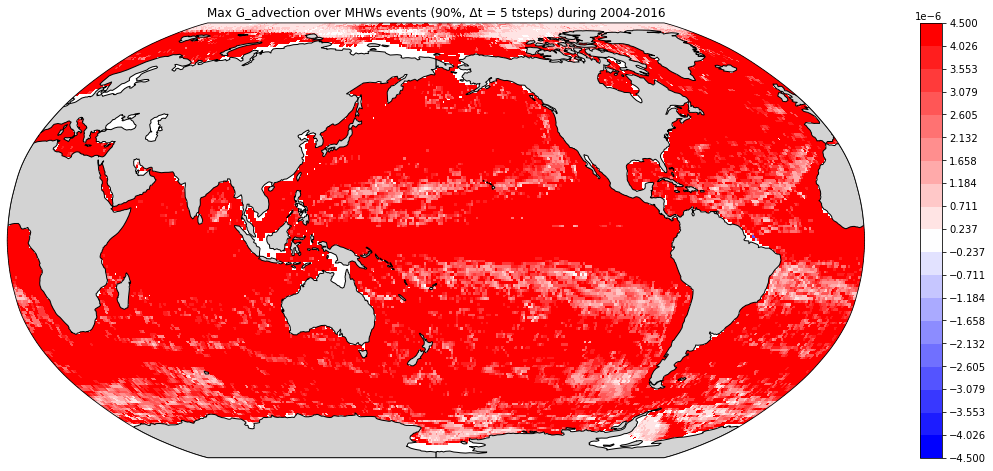

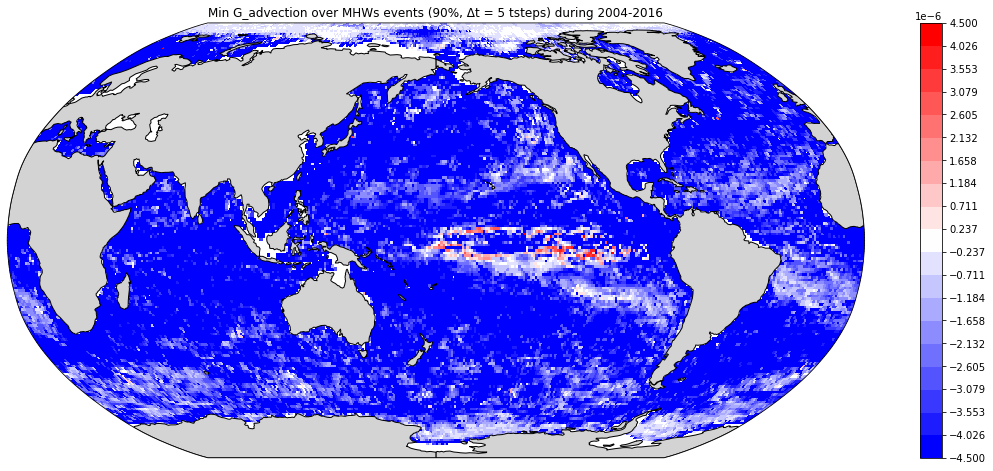

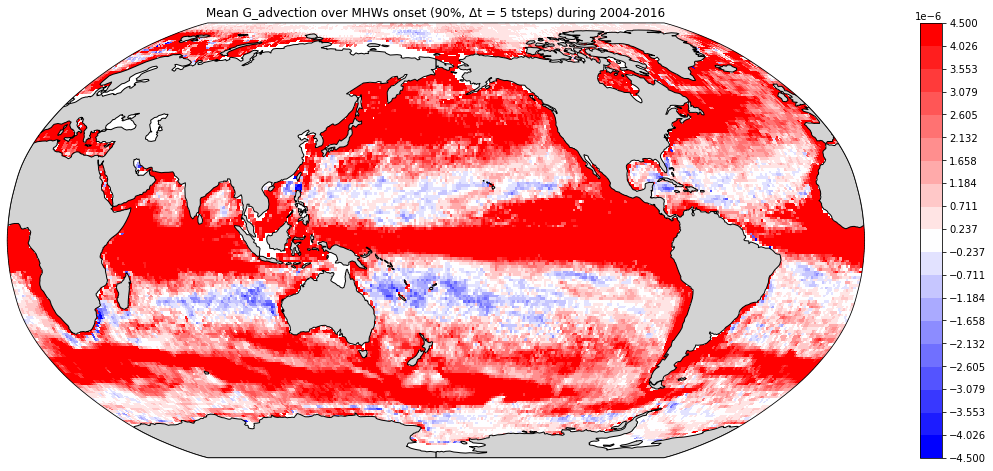

...

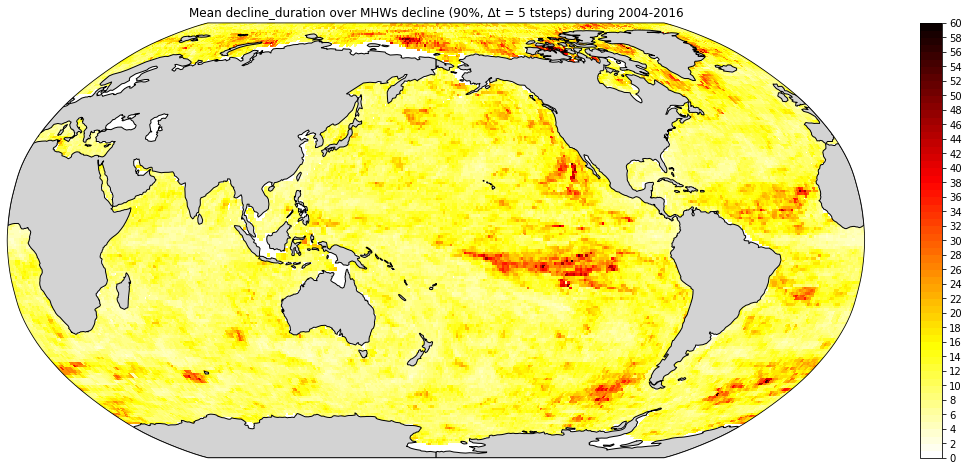

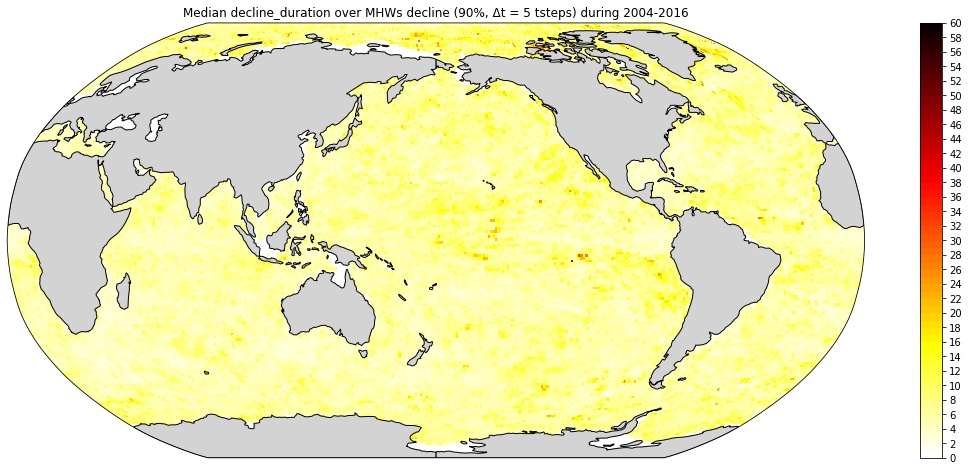

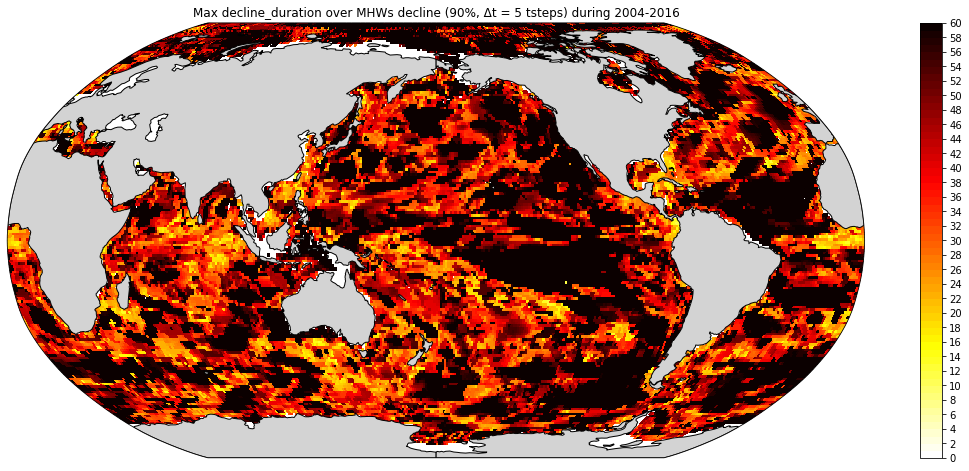

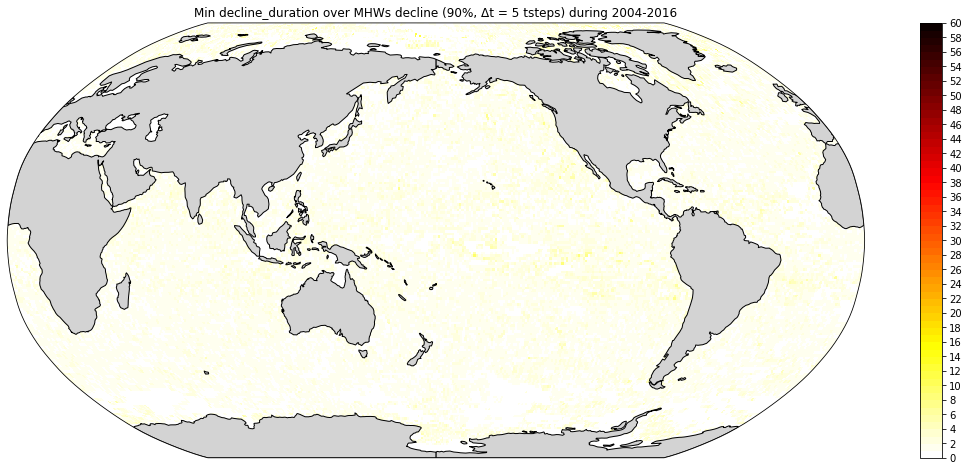

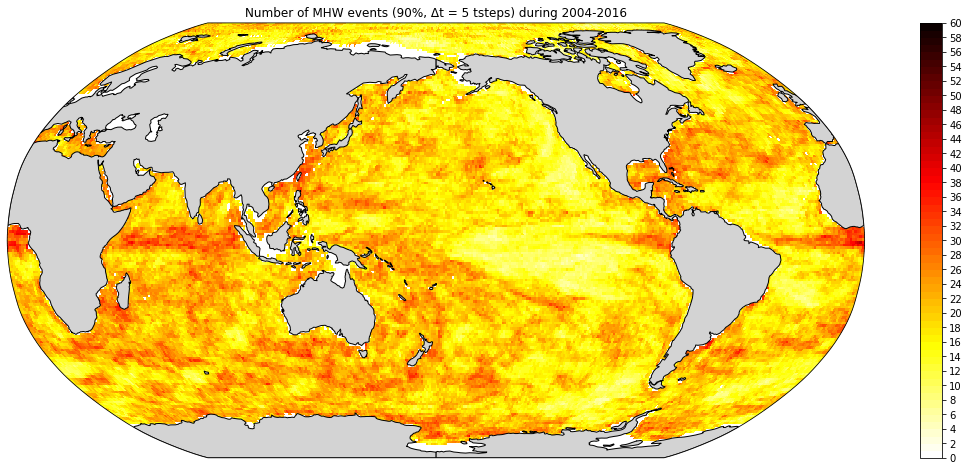

In [36]:
# Maps for all variables (mean, median, max, and min)

# Define keys and operations for data2plot calculation
operations = ['mean', 'median', 'max', 'min']
keys_list = ['G_advection_eventAve', 'G_advection_onsetAve', 'G_advection_declineAve',
             'G_diffusion_eventAve', 'G_diffusion_onsetAve', 'G_diffusion_declineAve',
             'G_total_eventAve', 'G_total_onsetAve', 'G_total_declineAve',
             'G_forcing_eventAve', 'G_forcing_onsetAve', 'G_forcing_declineAve',
             'adv_vConv_eventAve', 'adv_vConv_onsetAve', 'adv_vConv_declineAve',
             'dif_vConv_eventAve', 'dif_vConv_onsetAve', 'dif_vConv_declineAve',
             'data_used4MHWs_eventAve', 'data_used4MHWs_onsetAve', 'data_used4MHWs_declineAve',
             'events_duration_in_tsteps', 'onset_duration_in_tsteps', 'decline_duration_in_tsteps',
             'events_number']


# Loop over the keys and load the variables
for key in keys_list:
    # check if the key is in the list created from the .mat file
    if key in list(find_mhws_info_data.keys()):
        data_bfr = find_mhws_info_data[key].value
    else: # for the cases not included in the list created from the .mat file (like decline_duration_in_tsteps)
        data_bfr = eval(key)  
    # if statement for the cases that do not require operation
    if len(data_bfr.shape) == 2: # for this one, don't use the operations in the list above
        stat_tag = ''
        plot_map_from_scattered(XC_lon, YC_lat, data_bfr, key, year_start, year_end, save_path, stat_tag)
    elif len(data_bfr.shape) == 3:
        for operation in operations:
            data2plot = calculate_data2plot(data_values = data_bfr, operation = operation)
            stat_tag = operation.capitalize() # capital letter as the title of the plot starts with it
            plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)




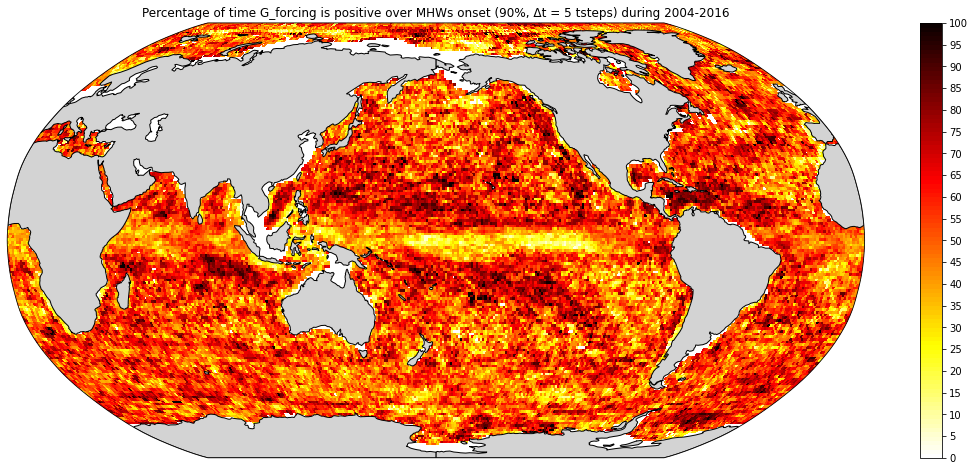

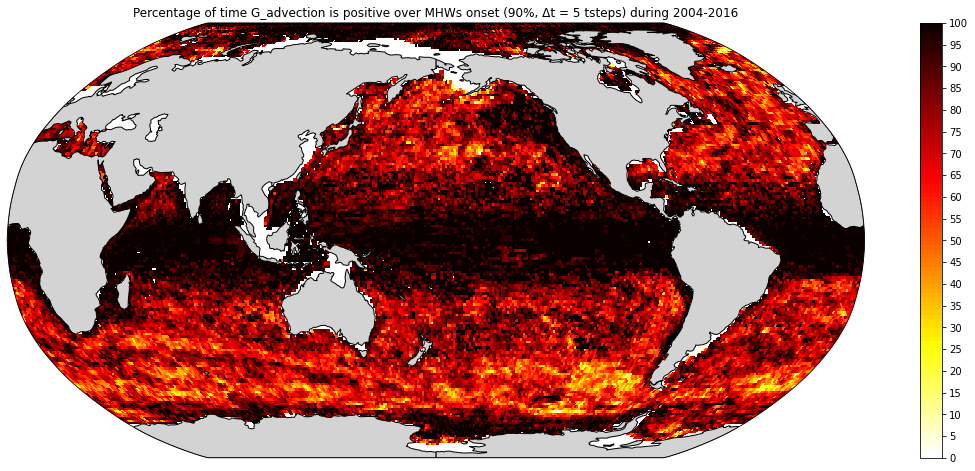

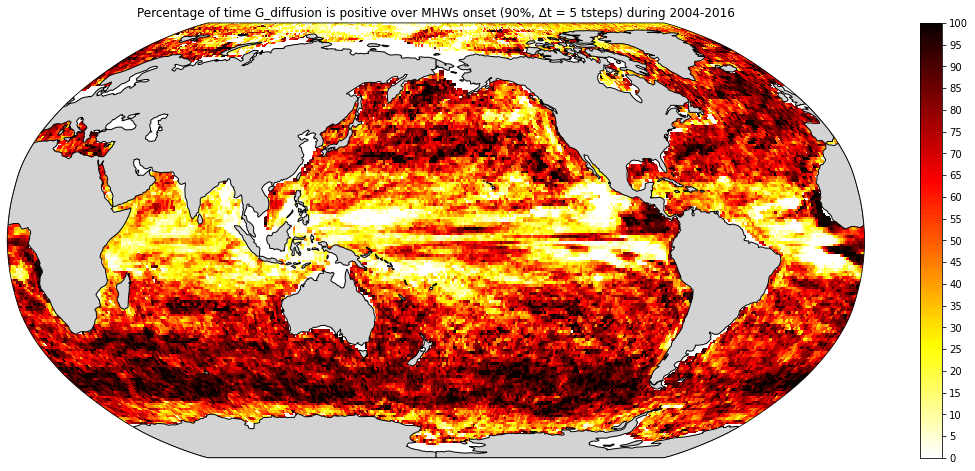

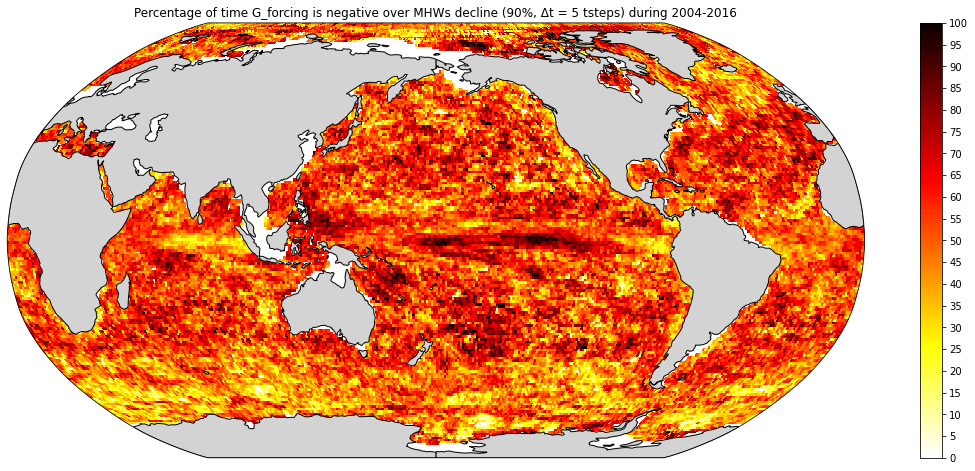

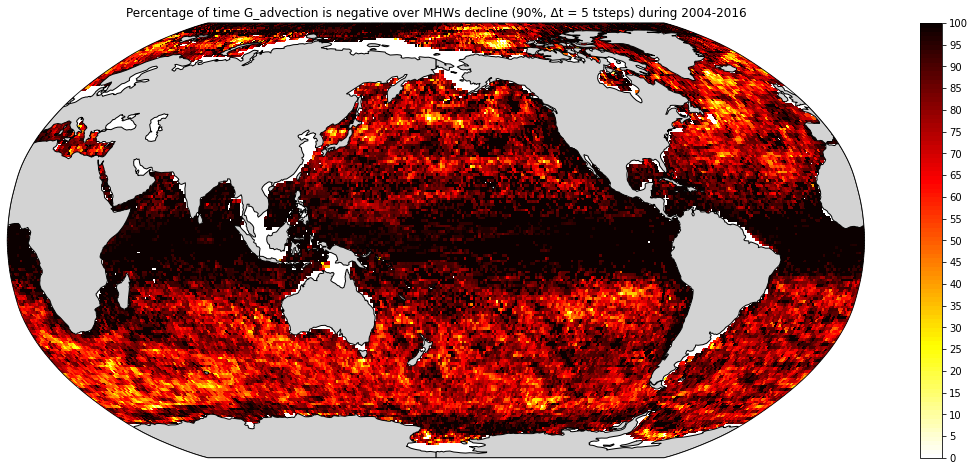

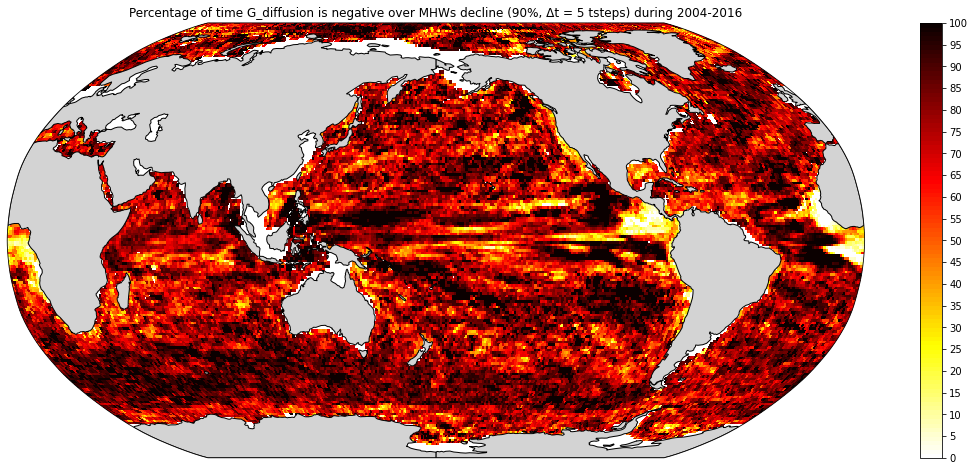

In [13]:
# Percentage of times a given term is positive (onset) or negative (decline)

# ONSET
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'onset', 'forcing', save_path)
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'onset', 'advection', save_path)
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'onset', 'diffusion', save_path)

# DECLINE
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'decline', 'forcing', save_path)
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'decline', 'advection', save_path)
map_contributor_positive_negative(find_mhws_info_data, XC_lon, YC_lat, 'decline', 'diffusion', save_path)


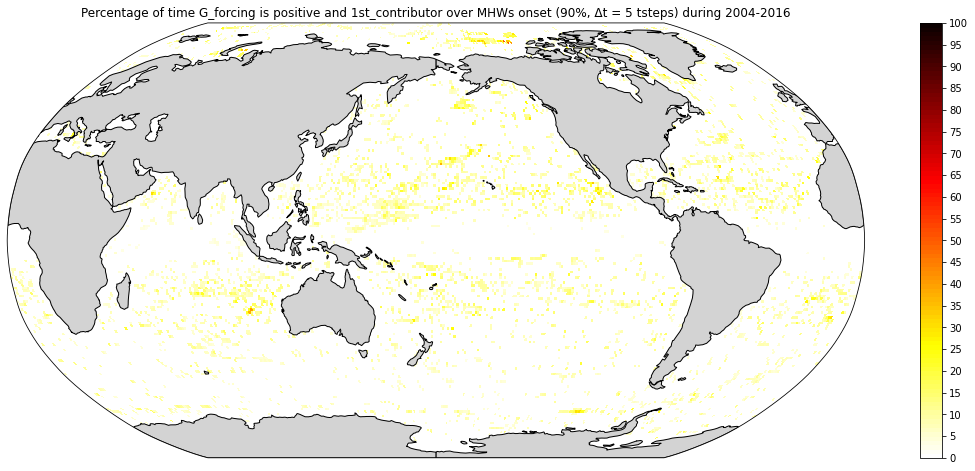

KeyboardInterrupt: 

In [14]:
# Percentage of times a given term is positive/negative and dominant
# title of the plots for the dominant: 1st_contributor

# ONSET
# G_forcing
map_first_or_third_contributor(find_mhws_info_data, 'G_forcing_onsetAve', 'G_diffusion_onsetAve', 'G_advection_onsetAve', np.greater, '1st_contributor')
# G_advection
map_first_or_third_contributor(find_mhws_info_data, 'G_advection_onsetAve', 'G_diffusion_onsetAve', 'G_forcing_onsetAve', np.greater, '1st_contributor')
# G_diffusion
map_first_or_third_contributor(find_mhws_info_data, 'G_diffusion_onsetAve', 'G_advection_onsetAve', 'G_forcing_onsetAve', np.greater, '1st_contributor')

# DECLINE
# G_forcing
map_first_or_third_contributor(find_mhws_info_data, 'G_forcing_declineAve', 'G_diffusion_declineAve', 'G_advection_declineAve', np.less, '1st_contributor')
# G_advection
map_first_or_third_contributor(find_mhws_info_data, 'G_advection_declineAve', 'G_diffusion_declineAve', 'G_forcing_declineAve', np.less, '1st_contributor')
# G_diffusion
map_first_or_third_contributor(find_mhws_info_data, 'G_diffusion_declineAve', 'G_advection_declineAve', 'G_forcing_declineAve', np.less, '1st_contributor')


In [ ]:
# Percentage of times a given term is positive/negative and the least dominant
# title of the plots for the less dominant: 3rd_contributor

# ONSET
# G_forcing
map_first_or_third_contributor(find_mhws_info_data, 'G_forcing_onsetAve', 'G_diffusion_onsetAve', 'G_advection_onsetAve', np.less, '3rd_contributor')
# G_advection
map_first_or_third_contributor(find_mhws_info_data, 'G_advection_onsetAve', 'G_diffusion_onsetAve', 'G_forcing_onsetAve', np.less, '3rd_contributor')
# G_diffusion
map_first_or_third_contributor(find_mhws_info_data, 'G_diffusion_onsetAve', 'G_advection_onsetAve', 'G_forcing_onsetAve', np.less, '3rd_contributor')

# DECLINE
# G_forcing
map_first_or_third_contributor(find_mhws_info_data, 'G_forcing_declineAve', 'G_diffusion_declineAve', 'G_advection_declineAve', np.greater, '3rd_contributor')
# G_advection
map_first_or_third_contributor(find_mhws_info_data, 'G_advection_declineAve', 'G_diffusion_declineAve', 'G_forcing_declineAve', np.greater, '3rd_contributor')
# G_diffusion
map_first_or_third_contributor(find_mhws_info_data, 'G_diffusion_declineAve', 'G_advection_declineAve', 'G_forcing_declineAve', np.greater, '3rd_contributor')


In [ ]:
# Percentage of times a given term is positive/negative and the 2nd dominant

# ONSET
# G_forcing
map_second_contributor(find_mhws_info_data, 'G_forcing_onsetAve', 'G_diffusion_onsetAve', 'G_advection_onsetAve', np.greater, '2nd_contributor')
# G_advection
map_second_contributor(find_mhws_info_data, 'G_advection_onsetAve', 'G_diffusion_onsetAve', 'G_forcing_onsetAve', np.greater, '2nd_contributor')
# G_diffusion
map_second_contributor(find_mhws_info_data, 'G_diffusion_onsetAve', 'G_advection_onsetAve', 'G_forcing_onsetAve', np.greater, '2nd_contributor')

# DECLINE
# G_forcing
map_second_contributor(find_mhws_info_data, 'G_forcing_declineAve', 'G_diffusion_declineAve', 'G_advection_declineAve', np.less, '2nd_contributor')
# G_advection
map_second_contributor(find_mhws_info_data, 'G_advection_declineAve', 'G_diffusion_declineAve', 'G_forcing_declineAve', np.less, '2nd_contributor')
# G_diffusion
map_second_contributor(find_mhws_info_data, 'G_diffusion_declineAve', 'G_advection_declineAve', 'G_forcing_declineAve', np.less, '2nd_contributor')


In [ ]:
ciao


In [ ]:
ciao

## OLD VERSION

### Plot global maps for each budget terms + DATA, for each phase of the event (onset and decline)

In [ ]:
# Load the MATLAB v7.3 .mat file
file_path = load_dir + f'ECCOv4r4_heat_zlev00_daily_{year_start}_{year_end}_prcnt90_noTrend_minLen_5tsteps_withAVE.mat'

mat_data = h5py.File(file_path, 'r')

# List the keys in the file
# print("Keys in the file:", list(mat_data.keys()))

# Access the data under the key '#refs#'
refs_data = mat_data['#refs#']

# Access the data under the key 'find_MHWs_info'
find_mhws_info_data = mat_data['find_MHWs_info']

# List the keys in the file find_MHWs_info'
# print(find_mhws_info_data.keys())

# Calculate the duration of the decline pahse (as a difference between the total duration and the duration of the onset phase)
decline_duration_in_tsteps = find_mhws_info_data['events_duration_in_tsteps'].value - find_mhws_info_data['onset_duration_in_tsteps'].value

In [ ]:
keys_list = ['G_advection_eventAve', 'G_advection_onsetAve', 'G_advection_declineAve', \
             'G_diffusion_eventAve', 'G_diffusion_onsetAve', 'G_diffusion_declineAve', \
             'G_total_eventAve', 'G_total_onsetAve', 'G_total_declineAve', \
             'G_forcing_eventAve', 'G_forcing_onsetAve', 'G_forcing_declineAve', \
             'adv_vConv_eventAve', 'adv_vConv_onsetAve', 'adv_vConv_declineAve', \
             'dif_vConv_eventAve', 'dif_vConv_onsetAve', 'dif_vConv_declineAve', \
             'data_used4MHWs_eventAve', 'data_used4MHWs_onsetAve', 'data_used4MHWs_declineAve', \
             'events_number', 'events_duration_in_tsteps', 'onset_duration_in_tsteps', 'decline_duration_in_tsteps']

# Loop over the keys and load the variables
for key in keys_list:
    if key == 'events_number':
        stat_tag = ''
        data2plot = find_mhws_info_data['events_number'].value
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)
    elif key == 'decline_duration_in_tsteps': # make plots for mean, median, max, min
        data2plot = np.nanmean(decline_duration_in_tsteps, axis=0)
        stat_tag = 'Mean'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)
        
        data2plot = np.nanmedian(decline_duration_in_tsteps, axis=0)
        stat_tag = 'Median'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)
        
        data2plot = np.nanmax(decline_duration_in_tsteps, axis=0)
        stat_tag = 'Max'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)
        
        data2plot = np.nanmin(decline_duration_in_tsteps, axis=0)
        stat_tag = 'Min'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)        
    else: # make plots for mean, median, max, min
        data2plot = np.nanmean(find_mhws_info_data[key].value, axis=0)
        stat_tag = 'Mean'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag) 
        
        data2plot = np.nanmedian(find_mhws_info_data[key].value, axis=0)
        stat_tag = 'Median'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag) 
        
        data2plot = np.nanmax(find_mhws_info_data[key].value, axis=0)
        stat_tag = 'Max'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)  
        
        data2plot = np.nanmin(find_mhws_info_data[key].value, axis=0)
        stat_tag = 'Min'
        plot_map_from_scattered(XC_lon, YC_lat, data2plot, key, year_start, year_end, save_path, stat_tag)        
        

In [ ]:
# ONSET

# Plot the percentage of how many times forc is the main contributor in the onset phase
data2plot = np.sum(find_mhws_info_data['G_forcing_onsetAve'].value>0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_forcing_onsetAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')

# Plot the percentage of how many times adv is the main contributor in the onset phase
data2plot = np.sum(find_mhws_info_data['G_advection_onsetAve'].value>0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_advection_onsetAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')

# Plot the percentage of how many times dif is the main contributor in the onset phase
data2plot = np.sum(find_mhws_info_data['G_diffusion_onsetAve'].value>0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_diffusion_onsetAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')

# DECLINE

# Plot the percentage of how many times forc is the main contributor in the decline phase
data2plot = np.sum(find_mhws_info_data['G_forcing_declineAve'].value<0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_forcing_declineAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')

# Plot the percentage of how many times adv is the main contributor in the decline phase
data2plot = np.sum(find_mhws_info_data['G_advection_declineAve'].value<0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_advection_declineAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')

# Plot the percentage of how many times dif is the main contributor in the decline phase
data2plot = np.sum(find_mhws_info_data['G_diffusion_declineAve'].value<0, axis=0) \
            /np.sum(~np.isnan(find_mhws_info_data['G_diffusion_declineAve']), axis=0)*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


In [ ]:
# Create three masks .... for the onset
mask1 = find_mhws_info_data['G_forcing_onsetAve'].value>0 

mask2 = find_mhws_info_data['G_forcing_onsetAve'].value>find_mhws_info_data['G_diffusion_onsetAve'].value 

mask3 = find_mhws_info_data['G_forcing_onsetAve'].value>find_mhws_info_data['G_advection_onsetAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_forcing the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


# Create three masks .... for the onset
mask1 = find_mhws_info_data['G_advection_onsetAve'].value>0 

mask2 = find_mhws_info_data['G_advection_onsetAve'].value>find_mhws_info_data['G_diffusion_onsetAve'].value 

mask3 = find_mhws_info_data['G_advection_onsetAve'].value>find_mhws_info_data['G_forcing_onsetAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_advection the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


# Create three masks .... for the onset
mask1 = find_mhws_info_data['G_diffusion_onsetAve'].value>0 

mask2 = find_mhws_info_data['G_diffusion_onsetAve'].value>find_mhws_info_data['G_advection_onsetAve'].value 

mask3 = find_mhws_info_data['G_diffusion_onsetAve'].value>find_mhws_info_data['G_forcing_onsetAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_diffusion the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


# Create three masks .... for the decline
mask1 = find_mhws_info_data['G_forcing_declineAve'].value<0 

mask2 = find_mhws_info_data['G_forcing_declineAve'].value<find_mhws_info_data['G_diffusion_declineAve'].value 

mask3 = find_mhws_info_data['G_forcing_declineAve'].value<find_mhws_info_data['G_advection_declineAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_forcing the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


# Create three masks .... for the decline
mask1 = find_mhws_info_data['G_advection_declineAve'].value<0 

mask2 = find_mhws_info_data['G_advection_declineAve'].value<find_mhws_info_data['G_diffusion_declineAve'].value 

mask3 = find_mhws_info_data['G_advection_declineAve'].value<find_mhws_info_data['G_forcing_declineAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_advection the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')


# Create three masks .... for the decline
mask1 = find_mhws_info_data['G_diffusion_declineAve'].value<0 

mask2 = find_mhws_info_data['G_diffusion_declineAve'].value<find_mhws_info_data['G_advection_declineAve'].value 

mask3 = find_mhws_info_data['G_diffusion_declineAve'].value<find_mhws_info_data['G_forcing_declineAve'].value

# Combine the masks
mask_all = np.bitwise_and(mask1, np.bitwise_and(mask2, mask3))

# Is G_diffusion the main contributor? 
data2plot = np.sum(mask_all, axis=0)/find_mhws_info_data['events_number']*100
plot_map_from_scattered(XC_lon = XC_lon, YC_lat = YC_lat, keyplot = '', d2plot = data2plot, year_start = '', year_end = '', save_path = '', stat_tag = '')



In [ ]:
ciao

In [ ]:
# # Plot average of G_total for each event in one point

# data2plot_3d = find_mhws_info_data['G_total_onsetAve'].value
# plt.plot(data2plot_3d[:,9,6586], '*')


In [ ]:
# This plot is just to confirm that np.sum(find_mhws_info_data['G_forcing_onsetAve'].value>0 is equal to the number of events
# data2plot = np.sum(find_mhws_info_data['G_forcing_onsetAve'].value>0, axis=0) \
# /find_mhws_info_data['events_number'].value*100
# plot_map_from_scattered(d2plot_lon = XC_lon_new, d2plot_lat = YC_lat_new, d2plot = data2plot, grid_x = grid_x, grid_y = grid_y)
